In [78]:
import os
import sys

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport

# Stations

In [79]:
for file in os.listdir("./datasets/knmi_station_data"):
    if not file.endswith(".txt"):
        continue
    with open(f"./datasets/knmi_station_data/{file}") as f:
        for _ in range(6):
            f.readline()
        line = f.readline()
        try:
            station_id, lat, lng, alt, *name = [s.strip() for s in line[1:].strip().split()]
            name = ' '.join(name)
            print(station_id, lat, lng, alt, name)
        except:
            print(file, line)

209 4.518 52.465 0.00 IJmond
323 3.884 51.527 1.40 Wilhelminadorp
311 3.672 51.379 0.00 Hoofdplaat
324 4.006 51.596 0.00 Stavenisse
249 4.979 52.644 -2.40 Berkhout
377 5.763 51.198 30.00 Ell
257 4.603 52.506 8.50 Wijk aan Zee
313 3.242 51.505 0.00 Vlakte van De Raan
258 5.401 52.649 7.30 Houtribdijk
215 4.437 52.141 -1.10 Voorschoten
315 3.998 51.447 0.00 Hansweert


# Columns

## 📍 Station Information

| Field        | Description                                      |
|--------------|--------------------------------------------------|
| `STN`        | Station number                                   |
| `LON(east)`  | Longitude (degrees east)                         |
| `LAT(north)` | Latitude (degrees north)                         |
| `ALT(m)`     | Altitude (in meters)                             |
| `NAME`       | Station name                                     |

## 📅 Time Information

| Field       | Description |
|-------------|-------------|
| `YYYYMMDD`  | Date (YYYY = year; MM = month; DD = day) |
| `HH`        | Hour (HH = hour; UT time. E.g., 12 UT = 13 MET, 14 MEZT. Hour block 05 = 04:00–05:00 UT) |

## 🌬️ Wind Data

| Field | Description |
|-------|-------------|
| `DD`  | Wind direction (in degrees), averaged over the last 10 minutes of the previous hour<br>(360 = north, 90 = east, 180 = south, 270 = west, 0 = calm, 990 = variable) |
| `FH`  | Hourly mean wind speed (in 0.1 m/s) |
| `FF`  | Mean wind speed (in 0.1 m/s) during last 10 minutes of the previous hour |
| `FX`  | Maximum wind gust (in 0.1 m/s) during the hour block |

## 🌡️ Temperature & Humidity

| Field   | Description |
|---------|-------------|
| `T`     | Temperature (in 0.1 °C) at 1.50 m height at observation time |
| `T10N`  | Minimum temperature (in 0.1 °C) at 10 cm height in the past 6 hours |
| `TD`    | Dew point temperature (in 0.1 °C) at 1.50 m at observation time |
| `U`     | Relative humidity (%) at 1.50 m height |

## 🌞 Radiation & Sunshine

| Field | Description |
|-------|-------------|
| `SQ`  | Sunshine duration (in 0.1 hours) per hour block, calculated from global radiation<br>(-1 = less than 0.05 h) |
| `Q`   | Global radiation (in J/cm²) per hour block |

## 🌧️ Precipitation

| Field | Description |
|-------|-------------|
| `DR`  | Duration of precipitation (in 0.1 hours) per hour block |
| `RH`  | Hourly precipitation amount (in 0.1 mm)<br>(-1 = less than 0.05 mm) |

## 🌬️ Atmospheric Pressure

| Field | Description |
|-------|-------------|
| `P`   | Air pressure (in 0.1 hPa), reduced to sea level, at observation time |

## 👁️ Visibility & Clouds

| Field | Description |
|-------|-------------|
| `VV`  | Horizontal visibility at observation time<br>(0 = <100 m, 1 = 100–200 m, ..., 89 = >70 km) |
| `N`   | Cloud cover (in octants, 0–8); 9 = sky invisible |

## 🌦️ Weather Conditions

| Field | Description |
|-------|-------------|
| `WW`  | Present weather code (00–99); observed visually or automatically |
| `IX`  | Weather code observation type:<br>1 = manned/visual; 2/3 = manned/omitted;<br>4 = automatic/visual; 5/6 = automatic/omitted; 7 = automatic sensor-based |

## 🌫️ Weather Phenomena Indicators

| Field | Description |
|-------|-------------|
| `M`   | Fog: 0 = none; 1 = occurred during the previous hour and/or observation |
| `R`   | Rain: 0 = none; 1 = occurred during the previous hour and/or observation |
| `S`   | Snow: 0 = none; 1 = occurred during the previous hour and/or observation |
| `O`   | Thunder: 0 = none; 1 = occurred during the previous hour and/or observation |
| `Y`   | Ice formation: 0 = none; 1 = occurred during the previous hour and/or observation |

# Base

In [80]:
def _convert_vv_to_meters(vv_code):
    if pd.isna(vv_code):
        return np.nan
    
    vv_code = int(vv_code)

    if 0 <= vv_code <= 49:
        return vv_code * 100 + 50
    elif vv_code == 50:
        return 5500
    elif 51 <= vv_code <= 55:
        return np.nan
    elif 56 <= vv_code <= 79:
        return int((vv_code - 56 + 6.5) * 1000)
    elif vv_code == 80:
        return 32500
    elif 81 <= vv_code <= 88:
        return int(32500 + (vv_code - 81) * 5000)
    elif vv_code == 89:
        return 70000
    else:
        return np.nan

def prepare_df(path: str) -> pd.DataFrame:
    try:
        header_line_index = -1
        column_names = []
        data_lines_start_index = -1

        # Find the header and its index more efficiently
        with open(path, 'r') as f:
            for i, line in enumerate(f):
                if line.strip().startswith('# STN,YYYYMMDD,'):
                    header_line_index = i
                    column_names = [col.strip() for col in line.strip().lstrip('#').split(',')]
                    data_lines_start_index = header_line_index + 1
                    break
        
        if header_line_index == -1:
            raise ValueError("Header line not found.")

        # Use pandas.read_csv directly with skiprows and comment character
        # This avoids reading the whole file into a list first for data lines
        # and then joining them back.
        df = pd.read_csv(
            path,
            names=column_names,
            skiprows=data_lines_start_index,
            comment='#',  # Lines starting with '#' will be ignored as comments
            skipinitialspace=True,
            na_values=['       ', '     '] # Add other common missing value representations if needed
        )

        if df.empty:
            raise ValueError("No data found after the header or all data was commented out.")

        # Convert 'HH' to string and zfill, then create 'Timestamp'
        # It's crucial to handle potential NaN values in 'YYYYMMDD' or 'HH'
        # if they are not guaranteed to be present or valid in all rows.
        df['HH'] = df['HH'].astype(int) - 1
        df['HH'] = df['HH'].astype(str).str.zfill(2)
        df['Timestamp'] = pd.to_datetime(df['YYYYMMDD'].astype(str) + df['HH'].astype(str), format="%Y%m%d%H", errors='coerce')
        
        df.set_index('Timestamp', inplace=True)
        
        # Columns to drop
        cols_to_drop = ['YYYYMMDD', 'HH']
        df.drop(columns=[col for col in cols_to_drop if col in df.columns], inplace=True)

        # Convert remaining columns to numeric, efficiently
        # Identify numeric columns once and convert
        # Exclude already processed or known non-numeric columns if necessary
        for col in df.columns:
            # This check is slightly redundant if YYYYMMDD and HH are already dropped,
            # but good for safety if they weren't or if other non-numeric columns exist.
            if df[col].dtype == 'object': # Only attempt conversion if the column is of object type
                try:
                    df[col] = pd.to_numeric(df[col], downcast='signed')
                except ValueError:
                    # Handle or log cases where a column expected to be numeric isn't
                    # For now, we'll coerce, which turns unparseable into NaT/NaN
                    df[col] = pd.to_numeric(df[col], errors='coerce', downcast='signed')
        df['VV_m'] = df['VV'].apply(_convert_vv_to_meters)
        return df

    except FileNotFoundError:
        print(f"Error: The file '{path}' was not found.")
        raise
    except ValueError as ve:
        print(f"ValueError: {ve}")
        raise
    except Exception as e:
        print(f"An unexpected error occurred: {e}")
        raise

df = prepare_df("./datasets/knmi_station_data/215.txt")
df.head()

,STN,DD,FH,FF,FX,T,T10N,TD,SQ,Q,...,N,U,WW,IX,M,R,S,O,Y,VV_m
Timestamp,,,,,,,,,,,,,,,,,,,,,
2015-01-01 00:00:00,215,210.0,50.0,50.0,70.0,27,NaN,8,0,0,...,0.0,87,10.0,7,0.0,0.0,0.0,0.0,0.0,4250.0
2015-01-01 01:00:00,215,220.0,50.0,50.0,70.0,26,NaN,4,0,0,...,0.0,85,10.0,7,0.0,0.0,0.0,0.0,0.0,7500.0
2015-01-01 02:00:00,215,200.0,50.0,40.0,80.0,23,NaN,2,0,0,...,0.0,86,NaN,5,0.0,0.0,0.0,0.0,0.0,10500.0
2015-01-01 03:00:00,215,210.0,40.0,40.0,70.0,21,NaN,1,0,0,...,0.0,87,NaN,5,0.0,0.0,0.0,0.0,0.0,10500.0
2015-01-01 04:00:00,215,190.0,50.0,50.0,80.0,19,NaN,2,0,0,...,1.0,88,NaN,5,0.0,0.0,0.0,0.0,0.0,10500.0


In [81]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 37248 entries, 2015-01-01 00:00:00 to 2025-05-19 23:00:00
Data columns (total 24 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   STN     37248 non-null  int64  
 1   DD      37219 non-null  float64
 2   FH      37219 non-null  float64
 3   FF      37219 non-null  float64
 4   FX      37219 non-null  float64
 5   T       37248 non-null  int64  
 6   T10N    6208 non-null   float64
 7   TD      37248 non-null  int64  
 8   SQ      37248 non-null  int64  
 9   Q       37248 non-null  int64  
 10  DR      37248 non-null  int64  
 11  RH      37248 non-null  int64  
 12  P       37233 non-null  float64
 13  VV      37049 non-null  float64
 14  N       37094 non-null  float64
 15  U       37248 non-null  int64  
 16  WW      15128 non-null  float64
 17  IX      37248 non-null  int64  
 18  M       37045 non-null  float64
 19  R       37045 non-null  float64
 20  S       37045 non-null  float64
 21  

In [82]:
for col in df.columns:
    print(f"{col}: {len(df[col].value_counts())}")

STN: 1
DD: 38
FH: 21
FF: 22
FX: 33
T: 353
T10N: 295
TD: 307
SQ: 12
Q: 323
DR: 11
RH: 67
P: 711
VV: 79
N: 10
U: 76
WW: 41
IX: 3
M: 2
R: 2
S: 2
O: 2
Y: 2
VV_m: 78


# Auto report

In [10]:
profile = ProfileReport(df.drop(columns=['VV_m']).dropna(), title="Profiling Report")
profile

Render HTML: 100%|██████████| 1/1 [00:06<00:00,  6.48s/it]


<Axes: >

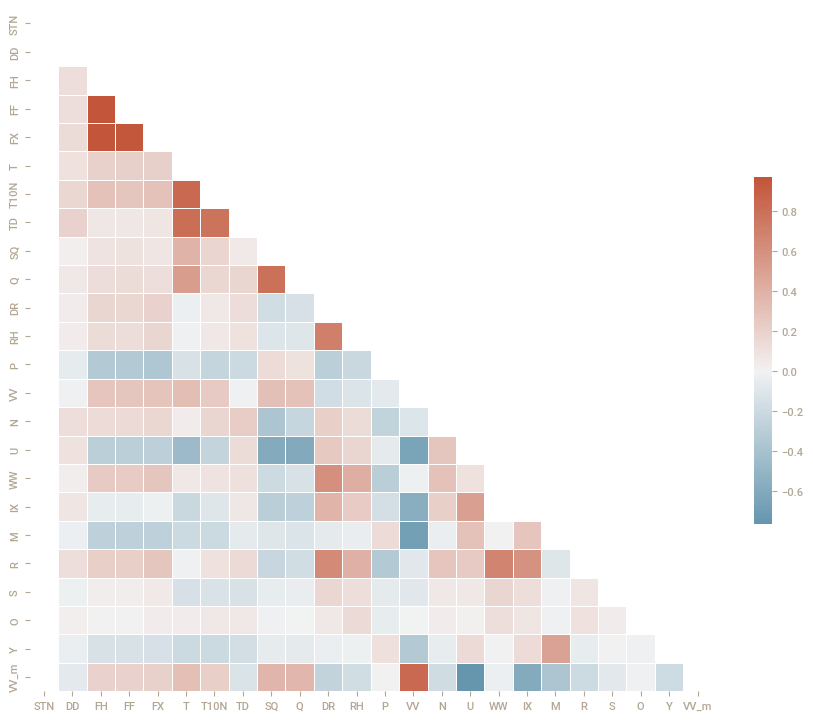

In [11]:
corr = df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))

cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(
    corr, mask=mask, cmap=cmap,
    center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5}
)

/home/next/magisterka/.venv/lib/python3.11/site-packages/seaborn/axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)
/home/next/magisterka/.venv/lib/python3.11/site-packages/seaborn/axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)
/home/next/magisterka/.venv/lib/python3.11/site-packages/seaborn/axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)
/home/next/magisterka/.venv/lib/python3.11/site-packages/seaborn/axisgrid.py:1615: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  func(x=x, y=y, **kwargs)
/home/next/magisterka/.venv/lib/python3.11/site-packages/sea

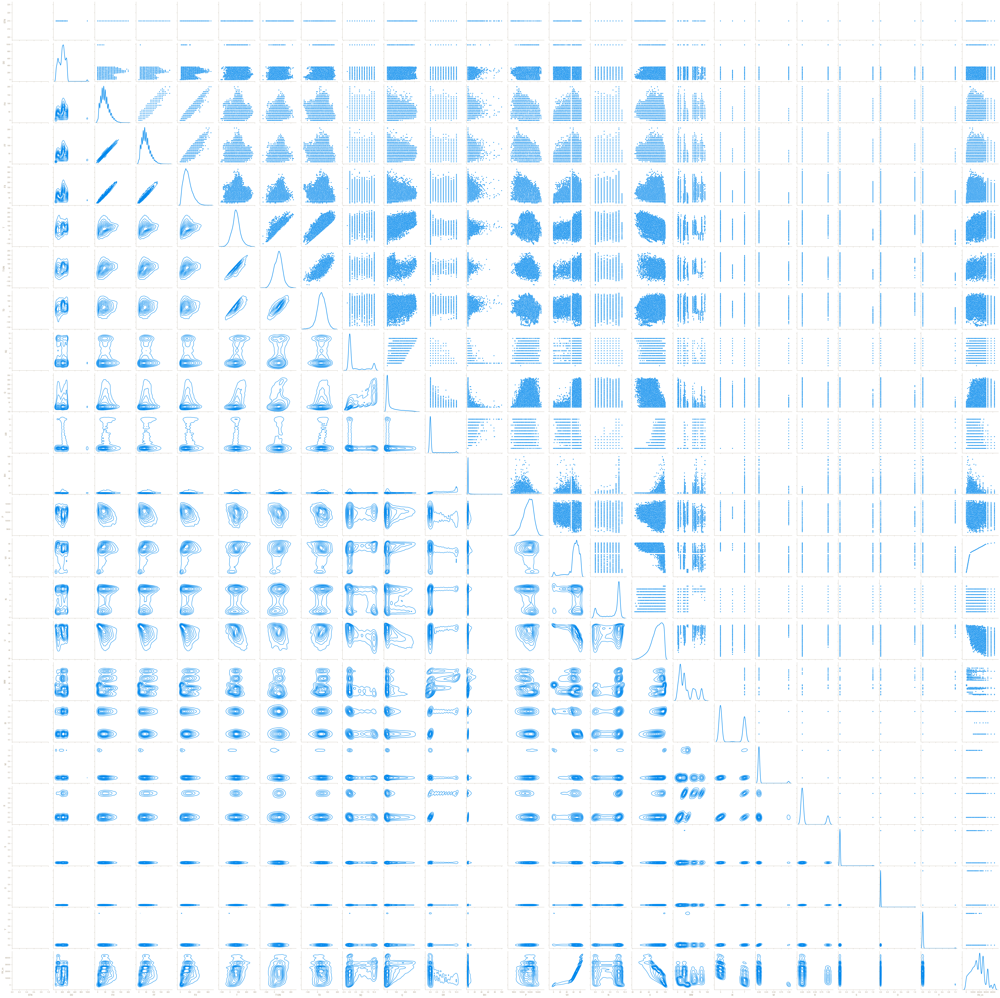

In [12]:
g = sns.PairGrid(df, diag_sharey=False)
g.map_upper(sns.scatterplot, s=15)
g.map_lower(sns.kdeplot)
g.map_diag(sns.kdeplot, lw=2)

# All stations EDA

In [130]:
dfs = []
for file in os.listdir("./datasets/knmi_station_data"):
    if not file.endswith(".txt"):
        continue
    df = prepare_df(f"./datasets/knmi_station_data/{file}")
    df = df.set_index('STN', append=True)
    # Check whether VV column has any noy nulls
    nulls = df['VV'].isna().sum()
    if nulls == len(df):
        print(f"DF {file} doesn't have VV")
        continue
    dfs.append(df)

df = pd.concat(dfs)
df.head()

DF 209.txt doesn't have VV
DF 311.txt doesn't have VV
DF 324.txt doesn't have VV
DF 257.txt doesn't have VV
DF 313.txt doesn't have VV
DF 258.txt doesn't have VV
DF 315.txt doesn't have VV


,,DD,FH,FF,FX,T,T10N,TD,SQ,Q,DR,...,N,U,WW,IX,M,R,S,O,Y,VV_m
Timestamp,STN,,,,,,,,,,,,,,,,,,,,,
2011-01-01 00:00:00,323,250.0,30.0,40.0,50.0,40.0,NaN,39.0,0.0,0.0,0.0,...,7.0,99.0,32.0,7.0,1.0,0.0,0.0,0.0,0.0,150.0
2011-01-01 01:00:00,323,270.0,40.0,40.0,50.0,41.0,NaN,40.0,0.0,0.0,0.0,...,8.0,99.0,20.0,7.0,1.0,0.0,0.0,0.0,0.0,2550.0
2011-01-01 02:00:00,323,260.0,30.0,30.0,40.0,40.0,NaN,39.0,0.0,0.0,0.0,...,8.0,99.0,10.0,7.0,0.0,0.0,0.0,0.0,0.0,6500.0
2011-01-01 03:00:00,323,250.0,30.0,30.0,50.0,40.0,NaN,39.0,0.0,0.0,0.0,...,8.0,99.0,10.0,7.0,0.0,0.0,0.0,0.0,0.0,5500.0
2011-01-01 04:00:00,323,250.0,30.0,40.0,50.0,40.0,NaN,39.0,0.0,0.0,5.0,...,8.0,99.0,22.0,7.0,0.0,1.0,0.0,0.0,0.0,4350.0


In [131]:
df.xs(323, level='STN')

,DD,FH,FF,FX,T,T10N,TD,SQ,Q,DR,...,N,U,WW,IX,M,R,S,O,Y,VV_m
Timestamp,,,,,,,,,,,,,,,,,,,,,
2011-01-01 00:00:00,250.0,30.0,40.0,50.0,40.0,NaN,39.0,0.0,0.0,0.0,...,7.0,99.0,32.0,7.0,1.0,0.0,0.0,0.0,0.0,150.0
2011-01-01 01:00:00,270.0,40.0,40.0,50.0,41.0,NaN,40.0,0.0,0.0,0.0,...,8.0,99.0,20.0,7.0,1.0,0.0,0.0,0.0,0.0,2550.0
2011-01-01 02:00:00,260.0,30.0,30.0,40.0,40.0,NaN,39.0,0.0,0.0,0.0,...,8.0,99.0,10.0,7.0,0.0,0.0,0.0,0.0,0.0,6500.0
2011-01-01 03:00:00,250.0,30.0,30.0,50.0,40.0,NaN,39.0,0.0,0.0,0.0,...,8.0,99.0,10.0,7.0,0.0,0.0,0.0,0.0,0.0,5500.0
2011-01-01 04:00:00,250.0,30.0,40.0,50.0,40.0,NaN,39.0,0.0,0.0,5.0,...,8.0,99.0,22.0,7.0,0.0,1.0,0.0,0.0,0.0,4350.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-19 19:00:00,360.0,50.0,40.0,80.0,146.0,NaN,95.0,0.0,4.0,0.0,...,NaN,71.0,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN
2025-05-19 20:00:00,20.0,40.0,40.0,70.0,142.0,NaN,106.0,0.0,0.0,0.0,...,NaN,78.0,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN
2025-05-19 21:00:00,30.0,50.0,50.0,70.0,141.0,NaN,105.0,0.0,0.0,0.0,...,NaN,78.0,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN


In [132]:
df = df.reset_index()
df.head()

,Timestamp,STN,DD,FH,FF,FX,T,T10N,TD,SQ,...,N,U,WW,IX,M,R,S,O,Y,VV_m
0,2011-01-01 00:00:00,323,250.0,30.0,40.0,50.0,40.0,NaN,39.0,0.0,...,7.0,99.0,32.0,7.0,1.0,0.0,0.0,0.0,0.0,150.0
1,2011-01-01 01:00:00,323,270.0,40.0,40.0,50.0,41.0,NaN,40.0,0.0,...,8.0,99.0,20.0,7.0,1.0,0.0,0.0,0.0,0.0,2550.0
2,2011-01-01 02:00:00,323,260.0,30.0,30.0,40.0,40.0,NaN,39.0,0.0,...,8.0,99.0,10.0,7.0,0.0,0.0,0.0,0.0,0.0,6500.0
3,2011-01-01 03:00:00,323,250.0,30.0,30.0,50.0,40.0,NaN,39.0,0.0,...,8.0,99.0,10.0,7.0,0.0,0.0,0.0,0.0,0.0,5500.0
4,2011-01-01 04:00:00,323,250.0,30.0,40.0,50.0,40.0,NaN,39.0,0.0,...,8.0,99.0,22.0,7.0,0.0,1.0,0.0,0.0,0.0,4350.0


In [133]:
cols = df.columns.difference(['Timestamp', 'STN', 'IX'])
drop = df[cols].isnull().all(axis=1)
df_filtered = df[~drop]

df_filtered.head()

,Timestamp,STN,DD,FH,FF,FX,T,T10N,TD,SQ,...,N,U,WW,IX,M,R,S,O,Y,VV_m
0,2011-01-01 00:00:00,323,250.0,30.0,40.0,50.0,40.0,NaN,39.0,0.0,...,7.0,99.0,32.0,7.0,1.0,0.0,0.0,0.0,0.0,150.0
1,2011-01-01 01:00:00,323,270.0,40.0,40.0,50.0,41.0,NaN,40.0,0.0,...,8.0,99.0,20.0,7.0,1.0,0.0,0.0,0.0,0.0,2550.0
2,2011-01-01 02:00:00,323,260.0,30.0,30.0,40.0,40.0,NaN,39.0,0.0,...,8.0,99.0,10.0,7.0,0.0,0.0,0.0,0.0,0.0,6500.0
3,2011-01-01 03:00:00,323,250.0,30.0,30.0,50.0,40.0,NaN,39.0,0.0,...,8.0,99.0,10.0,7.0,0.0,0.0,0.0,0.0,0.0,5500.0
4,2011-01-01 04:00:00,323,250.0,30.0,40.0,50.0,40.0,NaN,39.0,0.0,...,8.0,99.0,22.0,7.0,0.0,1.0,0.0,0.0,0.0,4350.0


In [87]:
df['STN'].unique()

array([323, 249, 377, 215])

In [88]:
for station_id, group_df in df.groupby('STN'):
    sorted_timestamps = group_df['Timestamp'].sort_values()
    diffs = sorted_timestamps.diff()
    is_continuous = (diffs.iloc[1:] == pd.Timedelta(hours=1)).all()
    if not is_continuous:
        print(f"Station {station_id} is not continous")

Station 215 is not continous
Station 249 is not continous
Station 323 is not continous
Station 377 is not continous


In [89]:
len(df_filtered)

252655

In [124]:
def get_latex_table(df: pd.DataFrame, as_latex=True):
    min_ts = df['Timestamp'].min()
    max_ts =df['Timestamp'].max()
    should_have = (max_ts - min_ts) / np.timedelta64(1, 'h')
    station = df.iloc[0]['STN']
    df = df[df.columns.difference(['STN', 'Timestamp', 'year'])]
    have = len(df)
    res = df.describe().T
    res['count'] = res['count'].astype(int)
    res['missing'] = res['count'].apply(lambda c: f"{((1-(c/should_have))*100):.2f}%")
    res = res[['count', 'missing',  'mean', 'std', 'min', 'max']]
    # res.loc['Present %'] = pd.Series([have / should_have] + ['-'] * (len(res.columns) - 1), index=res.columns)

    if not as_latex:
        return res
    bracket = '}}}'
    print((
        res
        .to_latex(
            float_format="%.2f", 
            # caption="\\textit{Data source: own work / KNMI \\cite{KNMI_website}}",
            caption=f"Summary statistics for Station {station}",
            # label=f"tab:station_{station}",
        )
        # .replace('\\caption', '\\caption*')
        .replace('\\begin{tabular}', '\\centering\n\\begin{tabular}')
        .replace('VV_m', 'VV\_m')
        .replace('%', r'\%')
        .replace('\\begin{table}', '\\begin{table}[ht]')
        .replace('{lrlrrrr}', '{c|c|c|c|c|c|c}')
        .replace('\\toprule', '\\hline\n\\hline')
        .replace('\\midrule', '\\hline')
        .replace('\\bottomrule', '\\hline')
        .replace('\\end{tabular}', '\\end{tabular}\n\\caption*{\\textit{Data source: own work / KNMI \\cite{KNMI_website}}}')
        .replace('}}}', f'{bracket}\n\\label{{tab:station_{station}}}')
            # caption="\\textit{Data source: own work / KNMI \\cite{KNMI_website}}",

    ))

for station_id in df['STN'].unique():
    print(f"% {station_id} -----------")
    get_latex_table(df[df['STN'] == station_id])

% 323 -----------
\begin{table}[ht]
\caption{Summary statistics for Station 323}
\centering
\begin{tabular}{c|c|c|c|c|c|c}
\hline
\hline
 & count & missing & mean & std & min & max \\
\hline
DD & 37315 & 70.40\% & 186.98 & 113.24 & 0.00 & 990.00 \\
DR & 37314 & 70.40\% & 0.74 & 2.32 & 0.00 & 10.00 \\
FF & 37266 & 70.44\% & 49.90 & 27.16 & 0.00 & 230.00 \\
FH & 37265 & 70.44\% & 49.74 & 26.72 & 0.00 & 220.00 \\
FX & 37265 & 70.44\% & 79.51 & 41.01 & 0.00 & 350.00 \\
IX & 37992 & 69.86\% & 5.98 & 0.52 & 5.00 & 7.00 \\
M & 10260 & 91.86\% & 0.03 & 0.16 & 0.00 & 1.00 \\
N & 10261 & 91.86\% & 5.22 & 3.44 & 0.00 & 9.00 \\
O & 10260 & 91.86\% & 0.00 & 0.07 & 0.00 & 1.00 \\
P & 37315 & 70.40\% & 10165.06 & 115.38 & 9738.00 & 10485.00 \\
Q & 37677 & 70.11\% & 41.97 & 70.74 & 0.00 & 327.00 \\
R & 10260 & 91.86\% & 0.16 & 0.36 & 0.00 & 1.00 \\
RH & 37314 & 70.40\% & 0.72 & 3.67 & -1.00 & 96.00 \\
S & 10260 & 91.86\% & 0.02 & 0.15 & 0.00 & 1.00 \\
SQ & 37677 & 70.11\% & 2.16 & 3.72 & 0.00 & 10.00 

In [177]:
START_DATE = '2012-01-01'
END_DATE = '2012-12-31'
df_plots = df[(df['Timestamp'] >= START_DATE) & (df['Timestamp'] <= END_DATE)]

<Axes: >

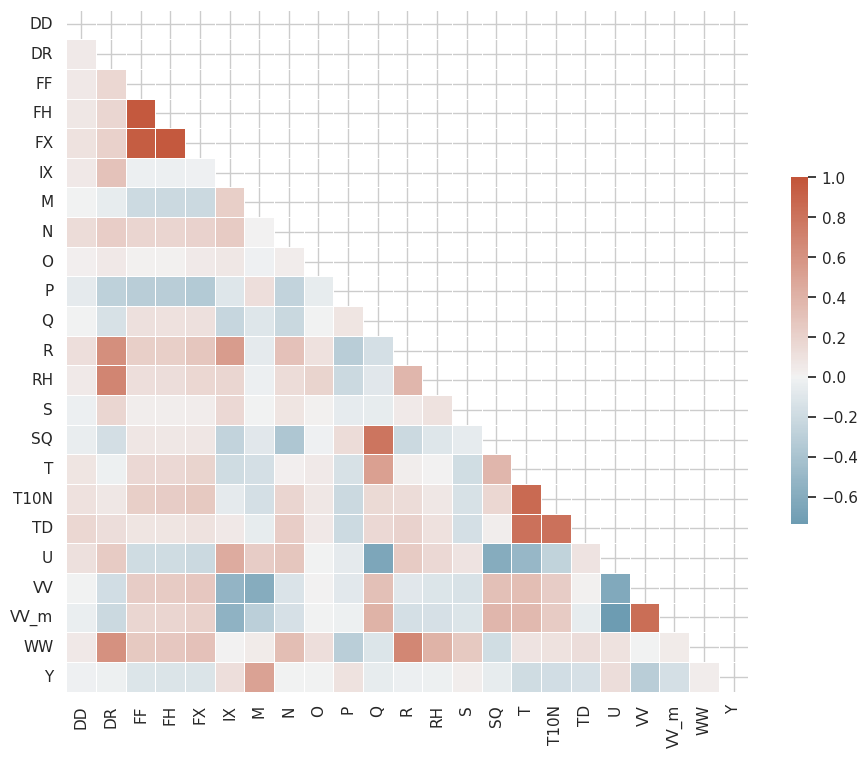

In [178]:
_d = df[df.columns.difference(['Timestamp', 'STN'])]
corr = _d.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1.0, center=0, square=True, linewidths=0.5, cbar_kws={"shrink": 0.5})

<Axes: xlabel='Timestamp', ylabel='VV_m'>

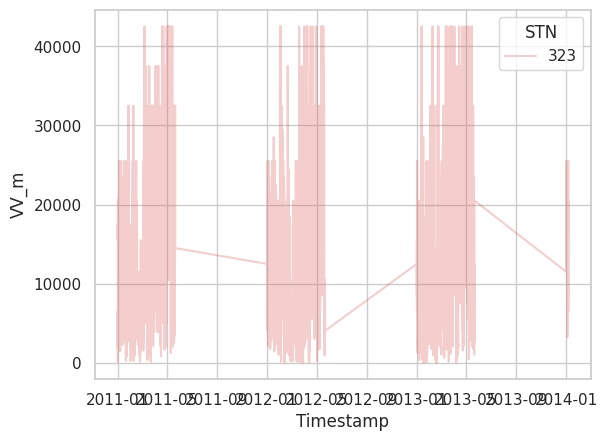

In [179]:
sns.lineplot(
    df[df['STN'] == 323],
    # df,
    x='Timestamp',
    y='VV_m',
    hue='STN',
    alpha=0.3,
    palette='hls'
)

In [129]:
df.head()

,Timestamp,VV_m,TimeDiff,Group
0,2021-01-01 00:00:00,-1.135601,NaN,0
1,2021-01-01 01:00:00,0.144524,1.0,0
2,2021-01-01 02:00:00,-1.918755,1.0,0
3,2021-01-01 03:00:00,1.430532,1.0,0
4,2021-01-01 04:00:00,-0.094605,1.0,0


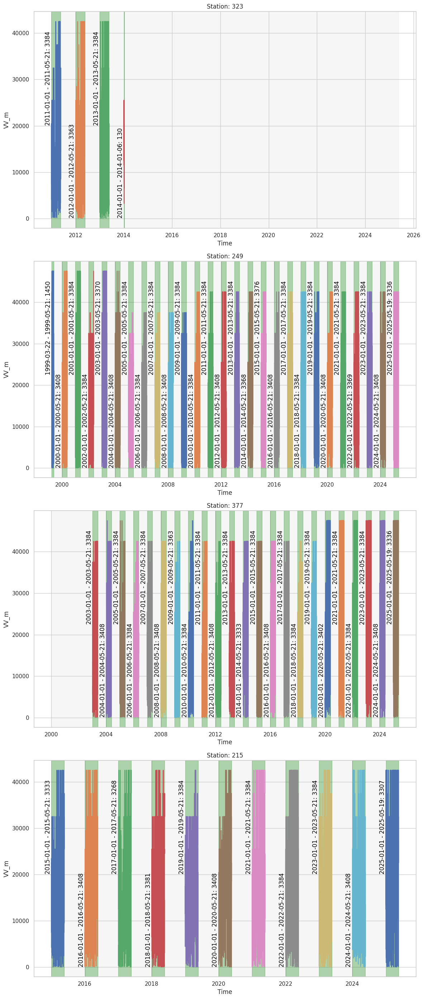

In [173]:
gap_threshold = pd.Timedelta(days=7)

stations = df['STN'].unique()
fig, axs = plt.subplots(nrows=len(stations), ncols=1, figsize=(12, 7 * len(stations)))
if len(stations) == 1:
    axs = [axs]  # Ensure iterable for one station

for ax, station in zip(axs, stations):
    df_stn = df[df['STN'] == station].copy()
    df_stn = df_stn.sort_values('Timestamp').reset_index(drop=True)

    # Drop rows with missing VV_m for background logic
    valid_data = df_stn.dropna(subset=['VV_m'])

    # Get sorted valid timestamps
    valid_times = valid_data['Timestamp'].sort_values().reset_index(drop=True)

    # Detect large gaps (> 7 days)
    time_diffs = valid_times.diff().fillna(pd.Timedelta(seconds=0))
    group = (time_diffs > gap_threshold).cumsum()

    # Set plot limits early for label positioning
    y_min, y_max = df_stn['VV_m'].min(), df_stn['VV_m'].max()

    # Plot grey background for entire time range first
    full_start, full_end = df_stn['Timestamp'].min(), df_stn['Timestamp'].max()
    ax.axvspan(full_start, full_end, color='lightgrey', alpha=0.2, zorder=-1)

    # Plot green background for continuous data segments
    i = 0
    for _, segment in valid_times.groupby(group):
        start, end = segment.iloc[0], segment.iloc[-1]

        # Green span for present data
        ax.axvspan(start, end, color='green', alpha=0.3)

        # Label
        count = len(segment)
        label = f"{start.date()} - {end.date()}: {count}"
        x_pos = start - pd.Timedelta(days=3)

        y_pos = y_max * 0.95 if i % 2 == 0 else y_min * 1.05
        va = 'top' if i % 2 == 0 else 'bottom'

        ax.text(
            x_pos, y_pos, label,
            horizontalalignment='right',
            verticalalignment=va,
            fontsize=12, color='black', rotation=90
        )
        i += 1

    # Detect large gaps for line breaking
    df_stn['TimeDiff'] = df_stn['Timestamp'].diff().dt.total_seconds().div(3600)
    df_stn['Group'] = (df_stn['TimeDiff'] > 168).cumsum()

    # Plot VV_m values (broken at large gaps)
    for _, group_data in df_stn.groupby('Group'):
        sns.lineplot(
            ax=ax, x='Timestamp', y='VV_m', data=group_data,
        )

    ax.set_title(f"Station: {station}")
    ax.set_xlabel('Time')
    ax.set_ylabel('VV_m')

plt.tight_layout()
plt.show()


In [ ]:
gap_threshold = pd.Timedelta(days=7)

stations = df['STN'].unique()

for station in stations:
    print("\\begin{table}[ht]")
    print(f"\\caption{{Data availability for Station {station}}}")
    print("\\centering")
    print("\\begin{tabular}{c|c|c|c}")
    print("\\hline\n\\hline")
    print("Station & Start Date & End Date & Missing \% \\")
    print("\\hline")
    df_stn = df[df['STN'] == station].copy()
    df_stn = df_stn.sort_values('Timestamp').reset_index(drop=True)

    valid_data = df_stn.dropna(subset=['VV_m'])
    valid_times = valid_data['Timestamp'].sort_values().reset_index(drop=True)
    time_diffs = valid_times.diff().fillna(pd.Timedelta(seconds=0))
    group = (time_diffs > gap_threshold).cumsum()

    full_start, full_end = df_stn['Timestamp'].min(), df_stn['Timestamp'].max()
    station_string = station
    for _, segment in valid_times.groupby(group):
        start, end = segment.iloc[0], segment.iloc[-1]
        should_have = (end - start) / np.timedelta64(1, 'h') + 1
        total = len(segment)
        missing = df_stn[(df_stn['Timestamp'] >= start) & (df_stn['Timestamp'] <= end)]['VV_m'].isna().sum()
        missing += should_have - total
        print(f"{station_string} & {start.year}-{start.month}-{start.day} & {end.year}-{end.month}-{end.day} & {int(missing)}/{int(should_have)} \\\\")
        station_string = ""
    # print("\\hline")
    print("\\hline")
    print("\\end{tabular}")
    print("\\caption*{\\textit{Data source: own work}}")
    print(f"\\label{{tab:data_availability_{station}}}")
    print("\\end{table}")

\begin{table}[ht]
\caption{Data availability for Station 323}
\centering
\begin{tabular}{c|c|c|c}
\hline
\hline
Station & Start Date & End Date & Missing \%
\hline
323 & 2011-1-1 & 2011-5-21 & 0/3384 \\
 & 2012-1-1 & 2012-5-21 & 90/3408 \\
 & 2013-1-1 & 2013-5-21 & 0/3384 \\
 & 2014-1-1 & 2014-1-6 & 0/130 \\
\hline
\end{tabular}
\caption*{\textit{Data source: own work}}
\label{tab:data_availability_323}
\end{table}
\begin{table}[ht]
\caption{Data availability for Station 249}
\centering
\begin{tabular}{c|c|c|c}
\hline
\hline
Station & Start Date & End Date & Missing \%
\hline
249 & 1999-3-22 & 1999-5-21 & 0/1450 \\
 & 2000-1-1 & 2000-5-21 & 0/3408 \\
 & 2001-1-1 & 2001-5-21 & 0/3384 \\
 & 2002-1-1 & 2002-5-21 & 0/3384 \\
 & 2003-1-1 & 2003-5-21 & 28/3384 \\
 & 2004-1-1 & 2004-5-21 & 0/3408 \\
 & 2005-1-1 & 2005-5-21 & 0/3384 \\
 & 2006-1-1 & 2006-5-21 & 0/3384 \\
 & 2007-1-1 & 2007-5-21 & 0/3384 \\
 & 2008-1-1 & 2008-5-21 & 0/3408 \\
 & 2009-1-1 & 2009-5-21 & 0/3384 \\
 & 2010-1-1 & 20

In [180]:
def plot_variable(df, variable):
    stations = df['STN'].unique()
    f, axs = plt.subplots(
        nrows=len(stations), ncols=1, 
        figsize=(12, 4 * len(stations))
    )

    min_value = df[variable].min()
    max_value = df[variable].max()

    for station, ax in zip(stations, axs):
        sns.lineplot(
            df[df['STN'] == station],
            x='Timestamp',
            y=variable,
            alpha=0.8,
            ax=ax,
            label=station
        )
        ax.set_ylim(min_value * 0.95, max_value * 1.05)


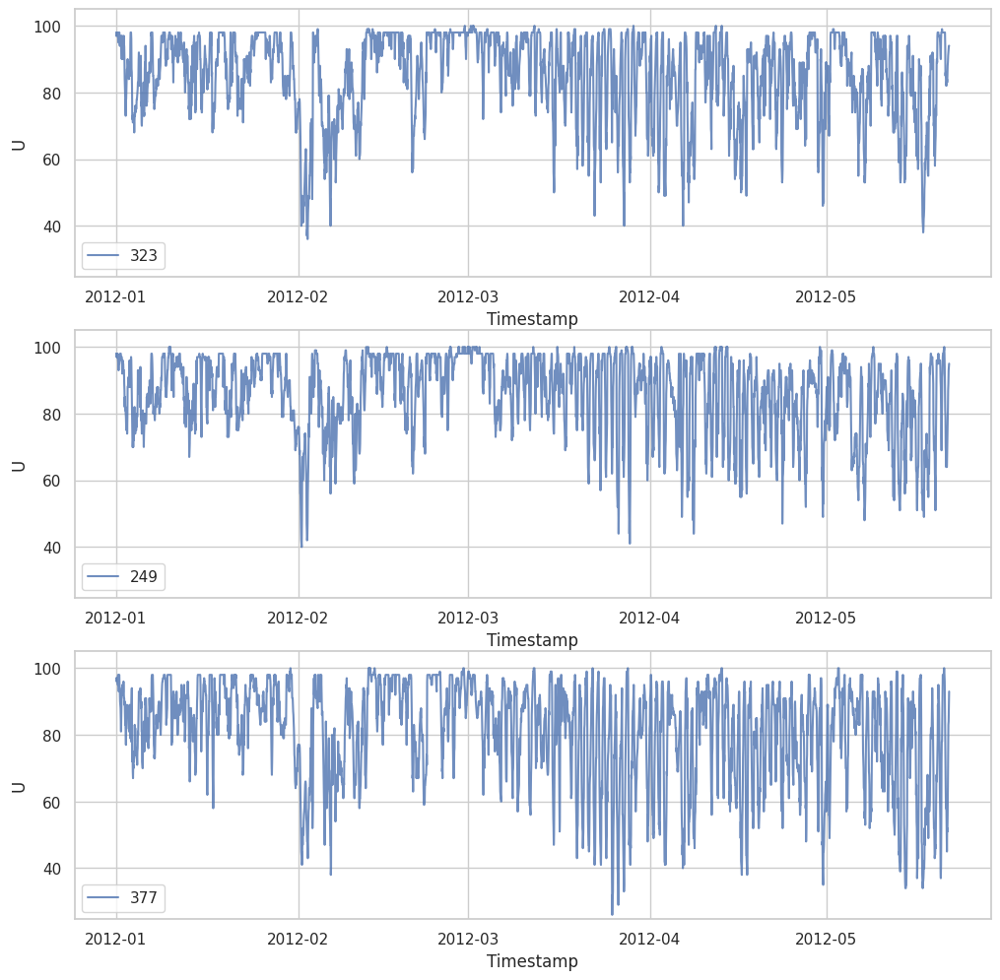

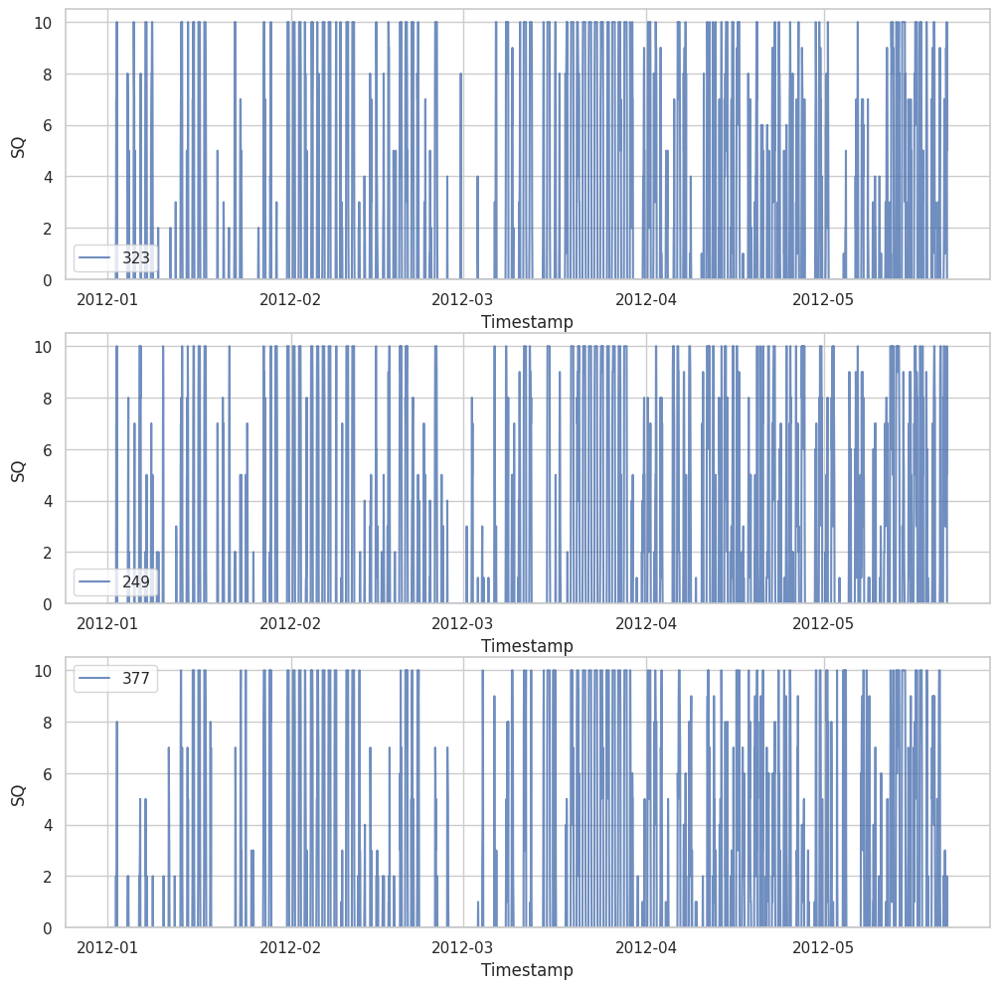

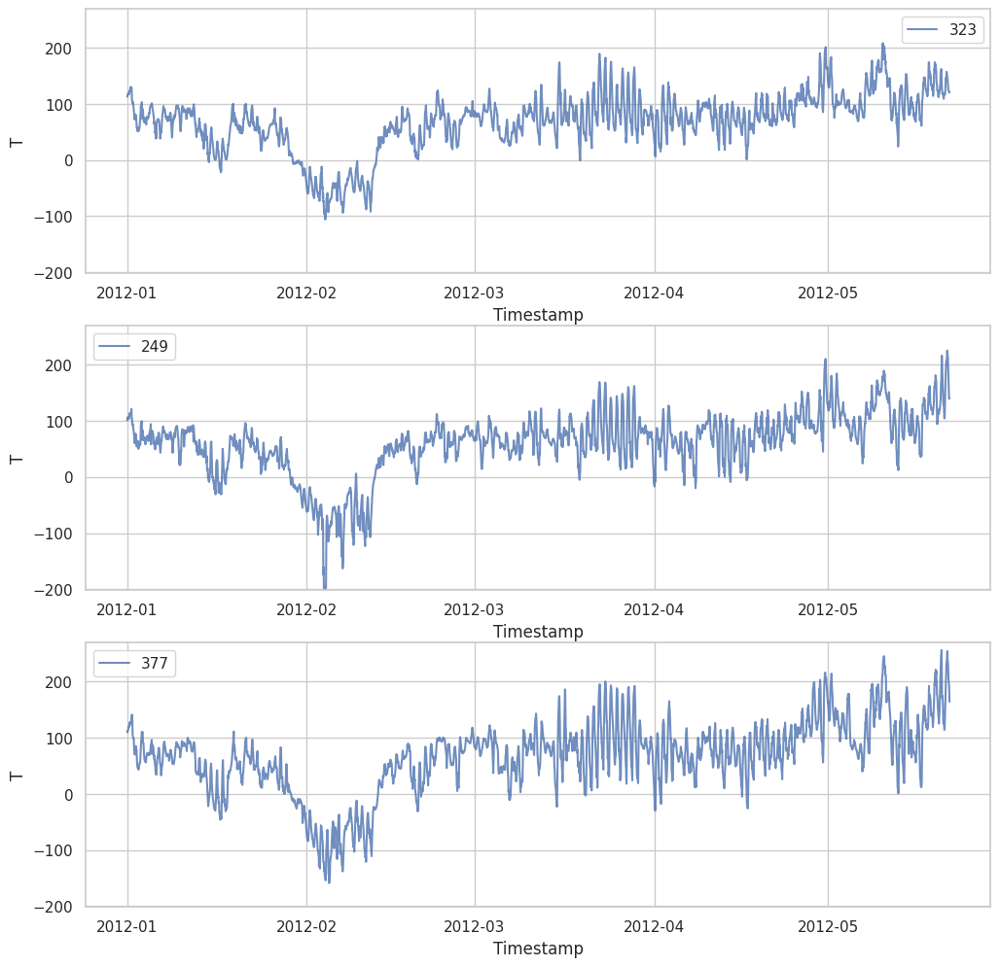

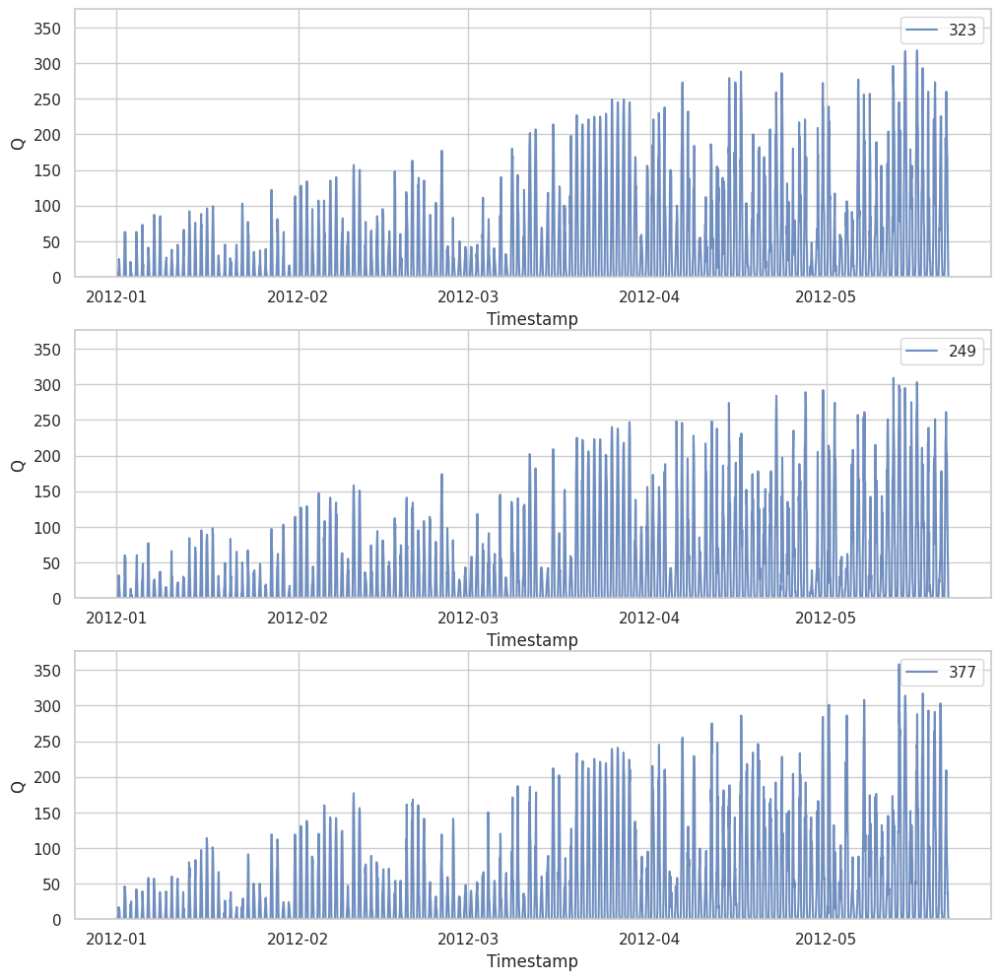

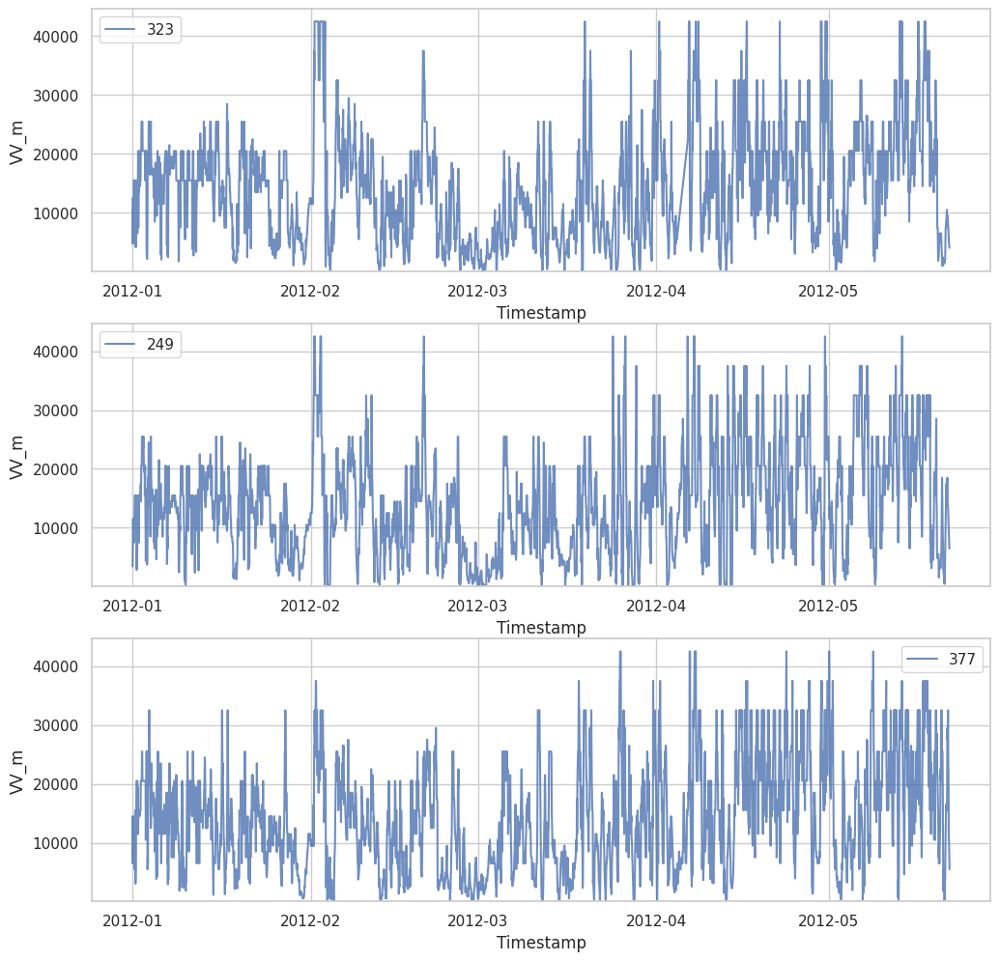

In [181]:
plot_variable(df_plots, 'U')
plot_variable(df_plots, 'SQ')
plot_variable(df_plots, 'T')
plot_variable(df_plots, 'Q')
plot_variable(df_plots, 'VV_m')

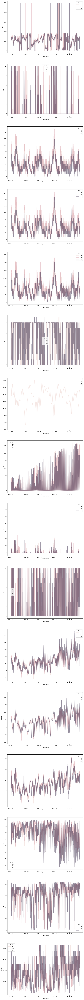

In [66]:
cols = df_plots.columns.difference([
    'STN',
    'Timestamp',
    'WW',
    'IX',
    'M',
    'R',
    'S',
    'O',
    'Y',
])

f, axs = plt.subplots(nrows=len(cols), ncols=1, figsize=(11, 9 * len(cols)))

for col, ax in zip(cols, axs):
    sns.lineplot(
        df_plots,
        x='Timestamp',
        y=col,
        hue='STN',
        alpha=0.5,
        ax=ax
    )